In [1]:
import re
import os
from glob import glob
import squidpy as sq
import numpy as np
from scipy import sparse
from sklearn import mixture
from scipy.cluster.hierarchy import linkage, cut_tree
from scipy.spatial.distance import pdist
from sklearn.preprocessing import MinMaxScaler
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
from matplotlib import font_manager

In [2]:
sc.set_figure_params(facecolor="white", figsize=(5, 5), dpi_save=300)
sc.settings.verbosity = 0

In [3]:
os.chdir('/mnt/home/qnyu/workspace/scOmics/Dataset/ST/file')

In [4]:
outdir = '/mnt/home/qnyu/workspace/scOmics/malignantModel/multi_tissue/plot'
sc.settings.figdir = outdir

In [5]:
sel_prefixs = ['10X_BRCA1_CancerFinder','10X_BRCA2_SpaCET','10X_OV_SpaCET','10X_Prostate_SpaCET',
               'RCC_CancerFinder','ccRCC_CancerFinder.6800STDY12499507','ccRCC_CancerFinder.6800STDY12499406',
               'ST_CancerFinder.GSM4284317_P2_ST_rep2','GSE208253_OSCC.s12','GSE208253_OSCC.s2',]

In [6]:
sample_dict = {}
for prefix in sel_prefixs:
    adata = sc.read_h5ad(f'{prefix}.h5ad')
    pred_df = pd.read_csv(f'{prefix}.proba.csv', index_col=0)
    score_df = pd.read_csv(f'{prefix}.sc_malignant_deg.aucell.tsv', index_col=0, sep='\t')

    adata.obs['scMalignantFinder_probability'] = pred_df.loc[adata.obs_names,'Tumor']
    adata.obs['sc_malignant_up_deg_score'] = score_df.loc[adata.obs_names,'Malignant_up']
    adata.obs['sc_malignant_down_deg_score'] = score_df.loc[adata.obs_names,'Malignant_down']

    adata.obs['probability_plus_up_score'] = (adata.obs['scMalignantFinder_probability']+adata.obs['sc_malignant_up_deg_score']) / 2
    
    sample_dict[prefix] = adata

In [7]:
for prefix in sel_prefixs:
    adata = sample_dict[prefix]
    library_id = list(adata.uns['spatial'].keys())[0]
    scale = adata.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef']
    img = sq.im.ImageContainer(adata.uns['spatial'][library_id]['images']['hires'],
                               scale=scale, library_id=library_id)
    
    sq.im.calculate_image_features(
        adata,
        img,
        features="summary",
        key_added="image_summary",
        n_jobs=20,
        scale=scale
    )
    
    scaler = MinMaxScaler()
    adata.obs['summary_ch-0_quantile-0.5'] = scaler.fit_transform(adata.obsm['image_summary']['summary_ch-0_quantile-0.5'].values.reshape(-1,1))[:,0]
    
    sample_dict[prefix] = adata

  0%|          | 0/3798 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/2518 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/3493 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/4371 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/1983 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/2145 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/3352 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/646 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/1559 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

  0%|          | 0/1836 [00:00<?, ?/s]

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  warnings.warn(
/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/xarray/core/utils.py:494: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from di

In [9]:
plt.figure(figsize=(26,5))
for count,prefix in enumerate(sel_prefixs):
    adata = sample_dict[prefix]
    matrix = adata.obs[['scMalignantFinder_probability','sc_malignant_up_deg_score','summary_ch-0_quantile-0.5']].values
    dist_matrix = pdist(matrix, metric='euclidean')
    linkage_matrix = linkage(dist_matrix, method='ward')
    clusters = cut_tree(linkage_matrix, n_clusters=3)
    adata.obs['cluster'] = pd.Categorical(clusters.flatten())
    tumor_cluster = adata.obs[['sc_malignant_up_deg_score','cluster']].groupby('cluster').mean().iloc[:,0].argmax()
    adata.obs['cluster2'] = pd.Categorical(adata.obs['cluster'].map(lambda x: 'Tumor' if x==tumor_cluster else 'Normal'), categories=['Normal','Tumor'])
    
    sample_dict[prefix] = adata

/tmp/ipykernel_79976/3749315121.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tumor_cluster = adata.obs[['sc_malignant_up_deg_score','cluster']].groupby('cluster').mean().iloc[:,0].argmax()
/tmp/ipykernel_79976/3749315121.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tumor_cluster = adata.obs[['sc_malignant_up_deg_score','cluster']].groupby('cluster').mean().iloc[:,0].argmax()
/tmp/ipykernel_79976/3749315121.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to a

<Figure size 2080x400 with 0 Axes>

In [153]:
prefix = 'ST_CancerFinder.GSM4284317_P2_ST_rep2'
adata = sample_dict[prefix]

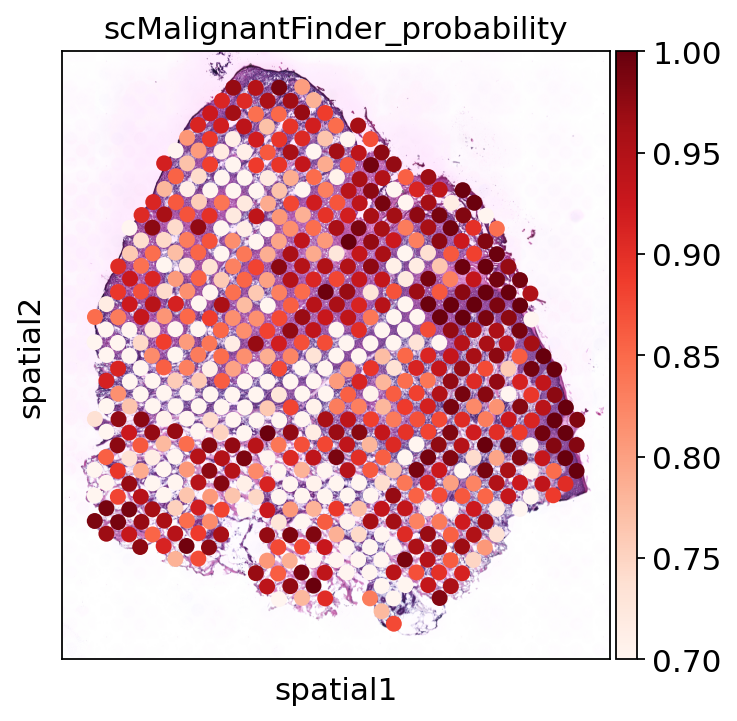

In [154]:
sc.pl.spatial(adata, color='scMalignantFinder_probability', cmap='Reds', vmin=0.7, vmax=1, size=1, save=f'_scMalignantFinder_probability.{prefix}.pdf')

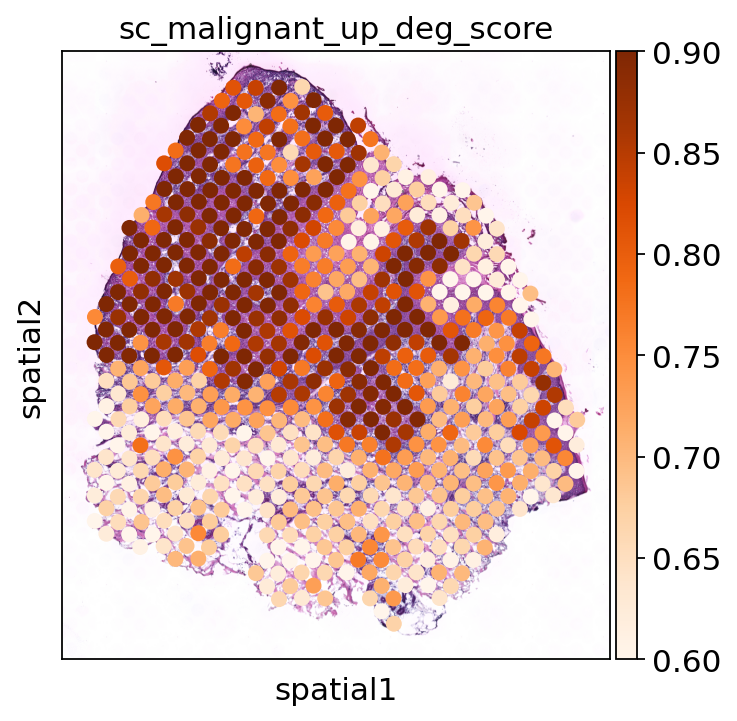

In [155]:
sc.pl.spatial(adata,  color='sc_malignant_up_deg_score', cmap='Oranges', vmin=0.6, vmax=0.9, size=1, save=f'_sc_malignant_up_deg_score.{prefix}.pdf')

In [157]:
sq.gr.spatial_neighbors(adata, n_rings=1, coord_type="grid", n_neighs=6)

raw_cluster = np.array(adata.obs['cluster2'].values)
spots = adata.obs_names.values

new_cluster = []

for cluster,spot in zip(raw_cluster,spots):
    nn_cluster = raw_cluster[np.where(np.array(adata.obsp["spatial_connectivities"][np.where(spots==spot)[0]].todense())[0]==1)[0]]

    if len(nn_cluster) < 2:
        new_cluster.append(cluster)
    else:
        unique_values, counts = np.unique(nn_cluster, return_counts=True)
        max_count_index = np.argmax(counts)
        most_common_element = unique_values[max_count_index]
        most_common_count = counts[max_count_index]

        if most_common_count / len(nn_cluster) > 0.5:
            new_cluster.append(most_common_element)
        else:
            new_cluster.append(cluster)

adata.obs['new_cluster'] = pd.Categorical(new_cluster, categories=['Normal','Tumor'])

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


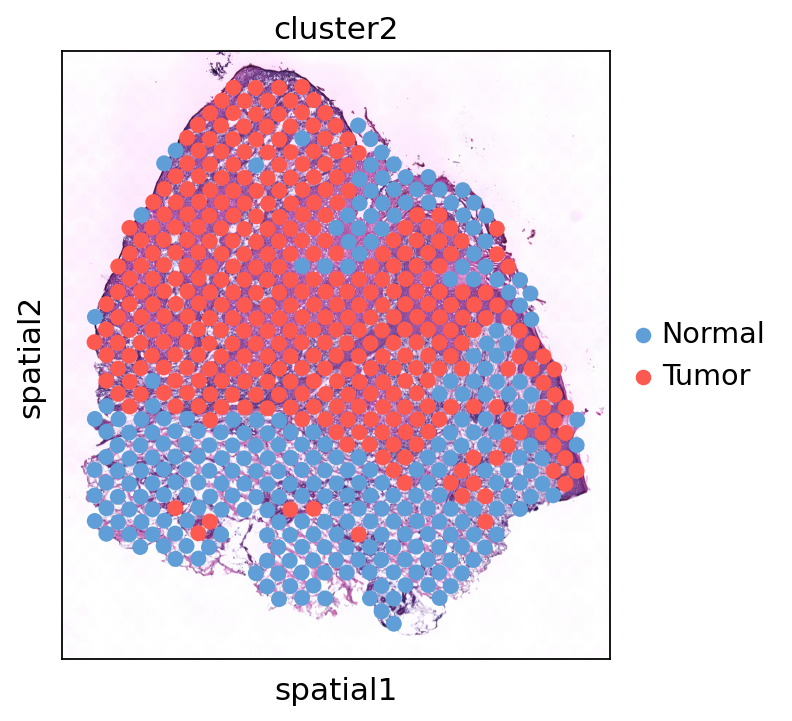

In [158]:
sc.pl.spatial(adata, color='cluster2', palette=['#5f9ed6','#fc5a50'], size=1, save=f'_raw_prediction.{prefix}.2.pdf')

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


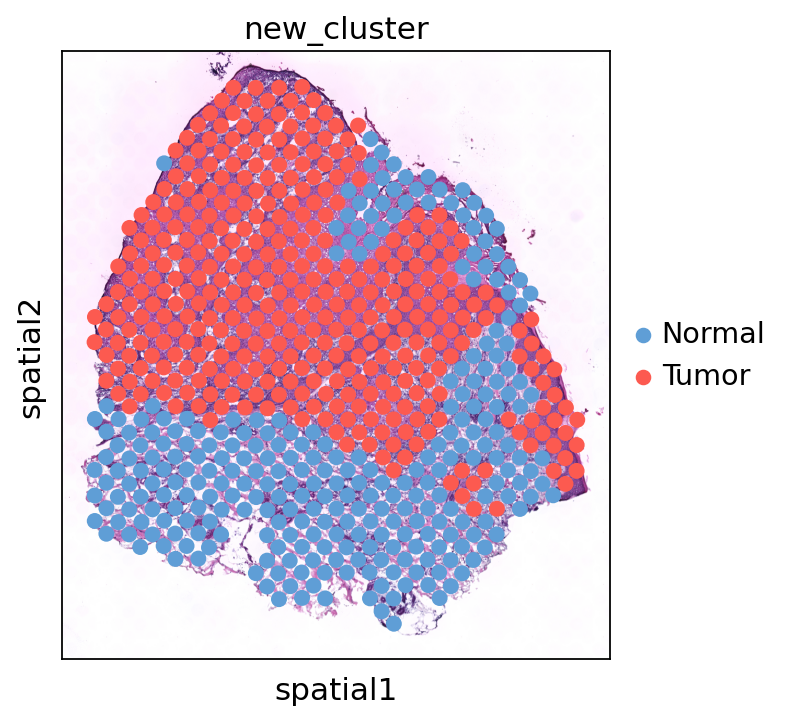

In [159]:
sc.pl.spatial(adata, color='new_cluster', palette=['#5f9ed6','#fc5a50'], size=1, save=f'_prediction.{prefix}.2.pdf')

In [160]:
prefix = 'RCC_CancerFinder'
adata = sample_dict[prefix]

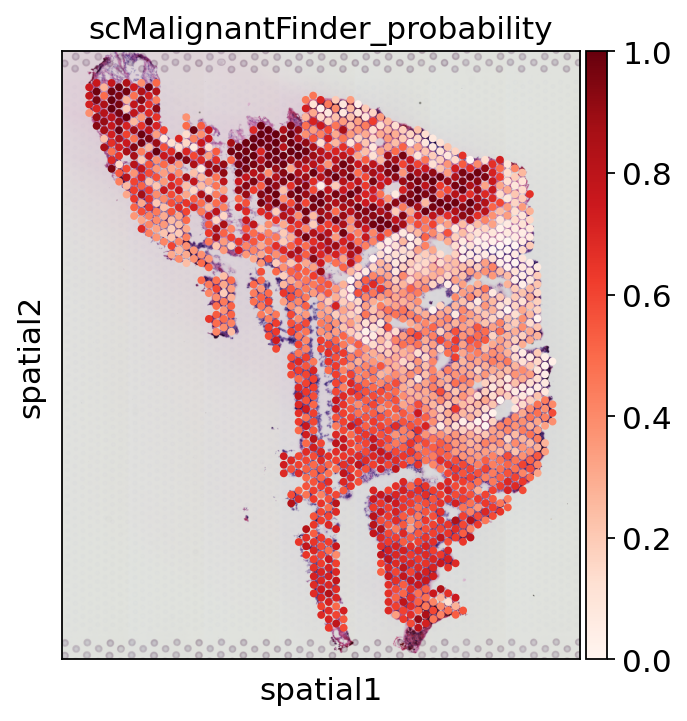

In [161]:
sc.pl.spatial(adata, color='scMalignantFinder_probability', cmap='Reds', vmin=0, vmax=1, size=1.4, save=f'_scMalignantFinder_probability.{prefix}.pdf')

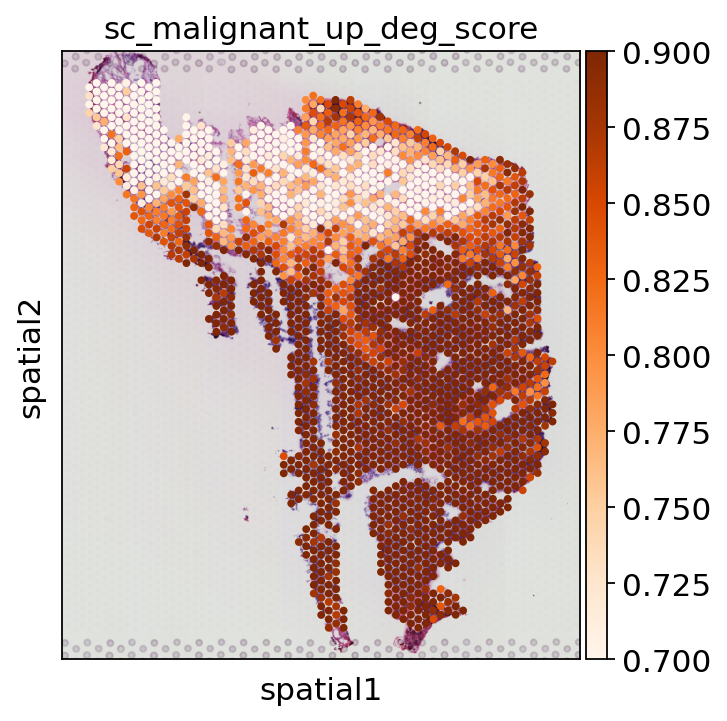

In [162]:
sc.pl.spatial(adata,  color='sc_malignant_up_deg_score', cmap='Oranges', vmin=0.7, vmax=0.9, size=1.4, save=f'_sc_malignant_up_deg_score.{prefix}.pdf')

In [164]:
sq.gr.spatial_neighbors(adata, n_rings=1, coord_type="grid", n_neighs=6)

raw_cluster = np.array(adata.obs['cluster2'].values)
spots = adata.obs_names.values

new_cluster = []

for cluster,spot in zip(raw_cluster,spots):
    nn_cluster = raw_cluster[np.where(np.array(adata.obsp["spatial_connectivities"][np.where(spots==spot)[0]].todense())[0]==1)[0]]

    if len(nn_cluster) < 2:
        new_cluster.append(cluster)
    else:
        unique_values, counts = np.unique(nn_cluster, return_counts=True)
        max_count_index = np.argmax(counts)
        most_common_element = unique_values[max_count_index]
        most_common_count = counts[max_count_index]

        if most_common_count / len(nn_cluster) > 0.5:
            new_cluster.append(most_common_element)
        else:
            new_cluster.append(cluster)

adata.obs['new_cluster'] = pd.Categorical(new_cluster, categories=['Normal','Tumor'])

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


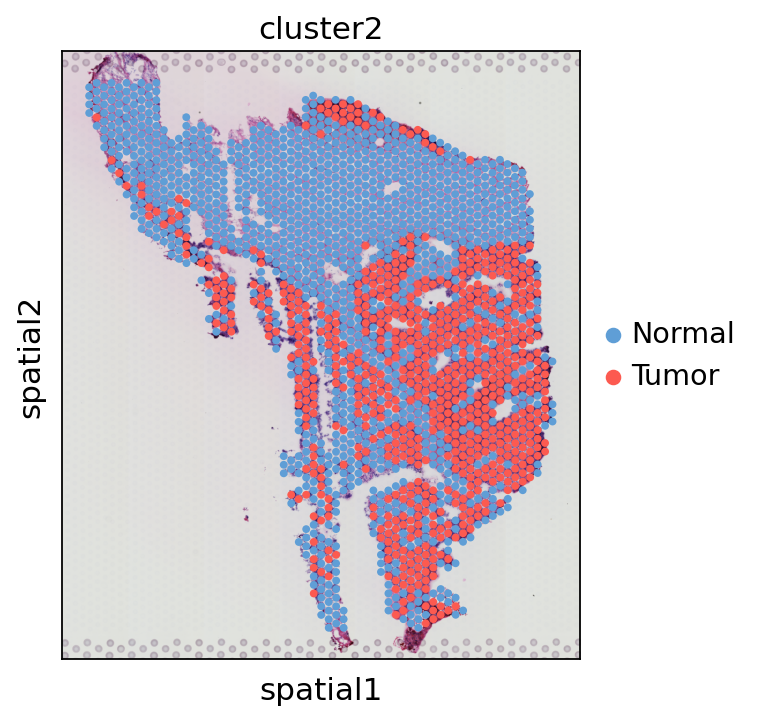

In [165]:
sc.pl.spatial(adata, color='cluster2', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_raw_prediction.{prefix}.2.pdf')

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


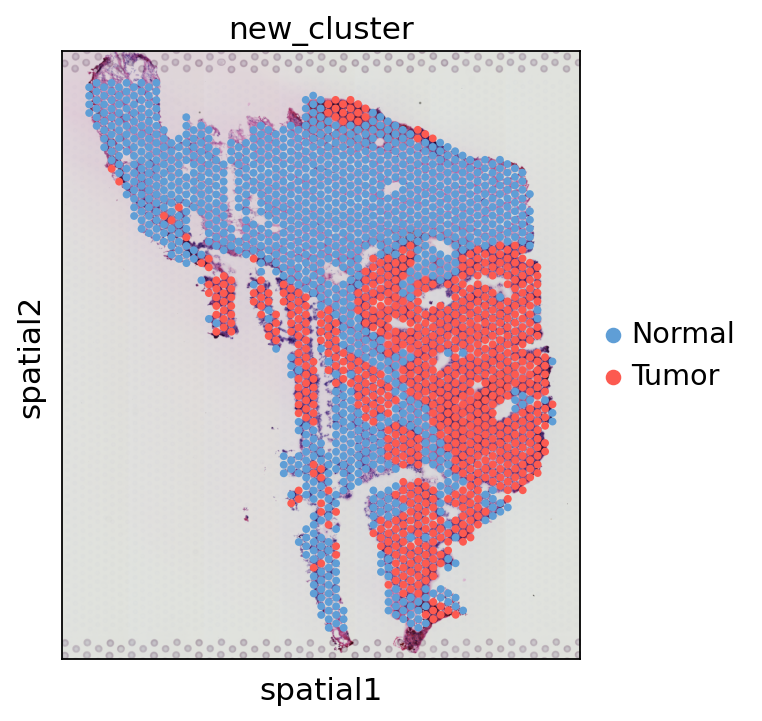

In [166]:
sc.pl.spatial(adata, color='new_cluster', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_prediction.{prefix}.2.pdf')

In [167]:
prefix = 'ccRCC_CancerFinder.6800STDY12499507'
adata = sample_dict[prefix]

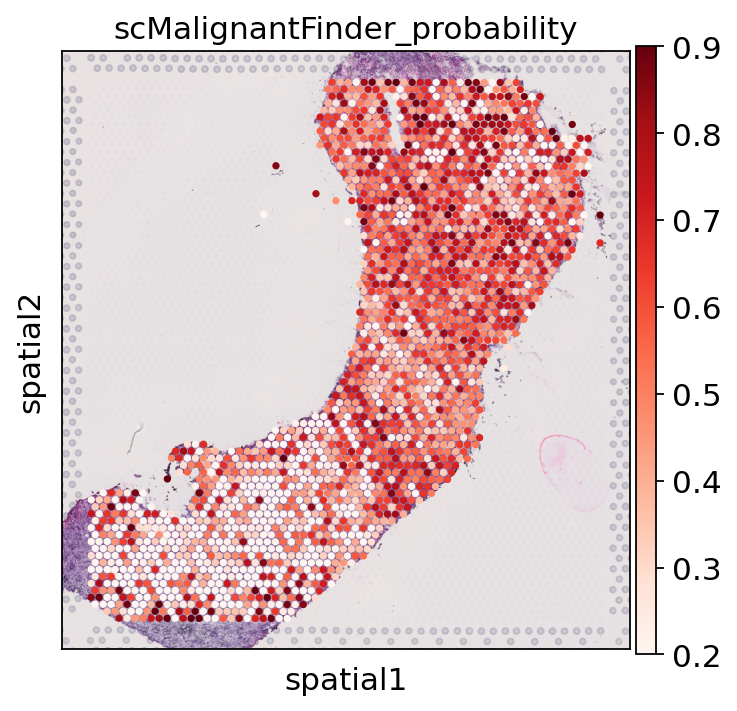

In [168]:
sc.pl.spatial(adata, color='scMalignantFinder_probability', cmap='Reds', vmin=0.2, vmax=0.9, size=1.4, save=f'_scMalignantFinder_probability.{prefix}.pdf')

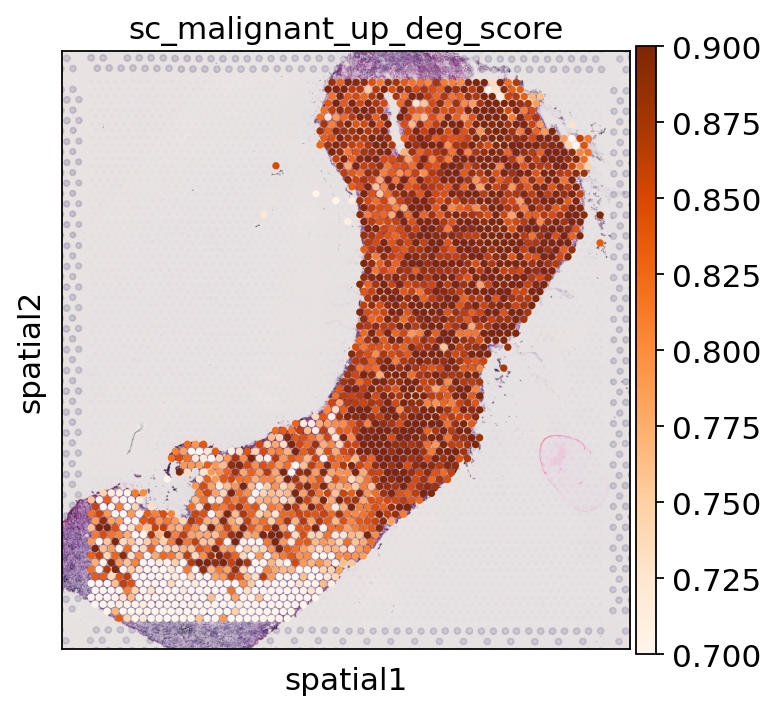

In [169]:
sc.pl.spatial(adata,  color='sc_malignant_up_deg_score', cmap='Oranges', vmin=0.7, vmax=0.9, size=1.4, save=f'_sc_malignant_up_deg_score.{prefix}.pdf')

In [171]:
sq.gr.spatial_neighbors(adata, n_rings=1, coord_type="grid", n_neighs=6)

raw_cluster = np.array(adata.obs['cluster2'].values)
spots = adata.obs_names.values

new_cluster = []

for cluster,spot in zip(raw_cluster,spots):
    nn_cluster = raw_cluster[np.where(np.array(adata.obsp["spatial_connectivities"][np.where(spots==spot)[0]].todense())[0]==1)[0]]

    if len(nn_cluster) < 2:
        new_cluster.append(cluster)
    else:
        unique_values, counts = np.unique(nn_cluster, return_counts=True)
        max_count_index = np.argmax(counts)
        most_common_element = unique_values[max_count_index]
        most_common_count = counts[max_count_index]

        if most_common_count / len(nn_cluster) > 0.5:
            new_cluster.append(most_common_element)
        else:
            new_cluster.append(cluster)

adata.obs['new_cluster'] = pd.Categorical(new_cluster, categories=['Normal','Tumor'])

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


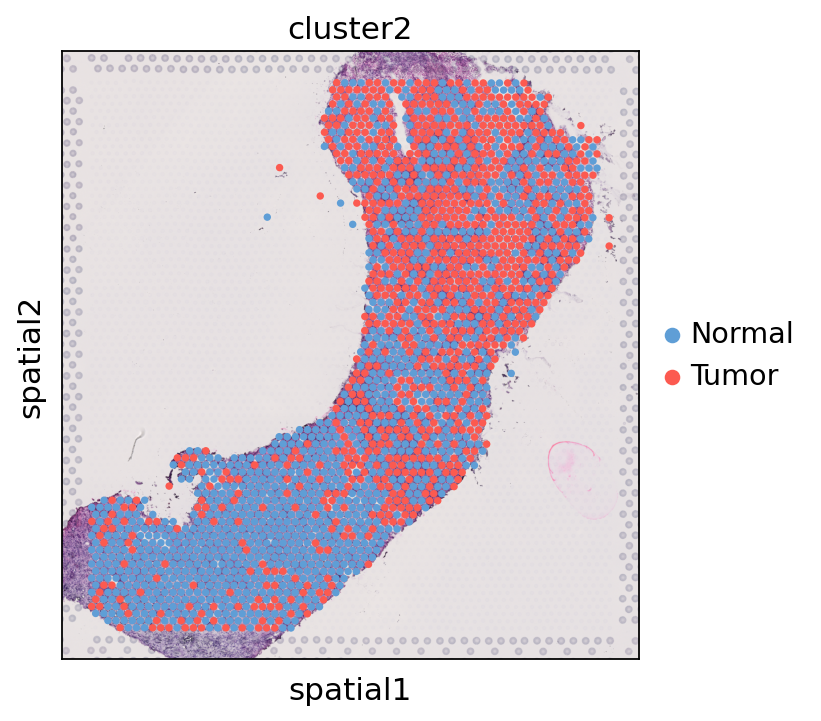

In [172]:
sc.pl.spatial(adata, color='cluster2', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_raw_prediction.{prefix}.2.pdf')

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


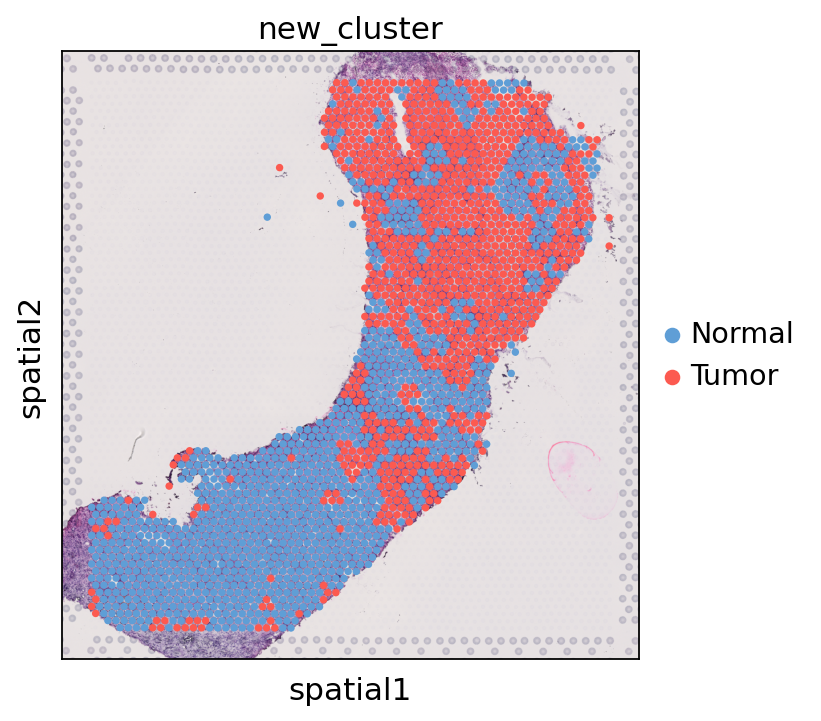

In [173]:
sc.pl.spatial(adata, color='new_cluster', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_prediction.{prefix}.2.pdf')

In [12]:
sel_prefixs

['10X_BRCA1_CancerFinder',
 '10X_BRCA2_SpaCET',
 '10X_OV_SpaCET',
 '10X_Prostate_SpaCET',
 'RCC_CancerFinder',
 'ccRCC_CancerFinder.6800STDY12499507',
 'ccRCC_CancerFinder.6800STDY12499406',
 'ST_CancerFinder.GSM4284317_P2_ST_rep2',
 'GSE208253_OSCC.s12',
 'GSE208253_OSCC.s2']

In [10]:
prefix = 'GSE208253_OSCC.s12'
adata = sample_dict[prefix]

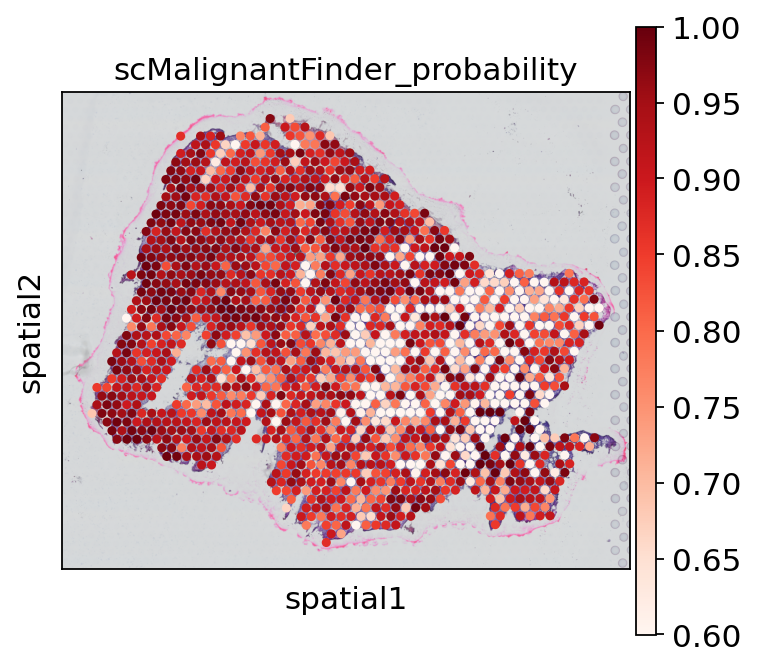

In [18]:
sc.pl.spatial(adata, color='scMalignantFinder_probability', cmap='Reds', vmin=0.6, vmax=1, size=1.4, save=f'_scMalignantFinder_probability.{prefix}.pdf')

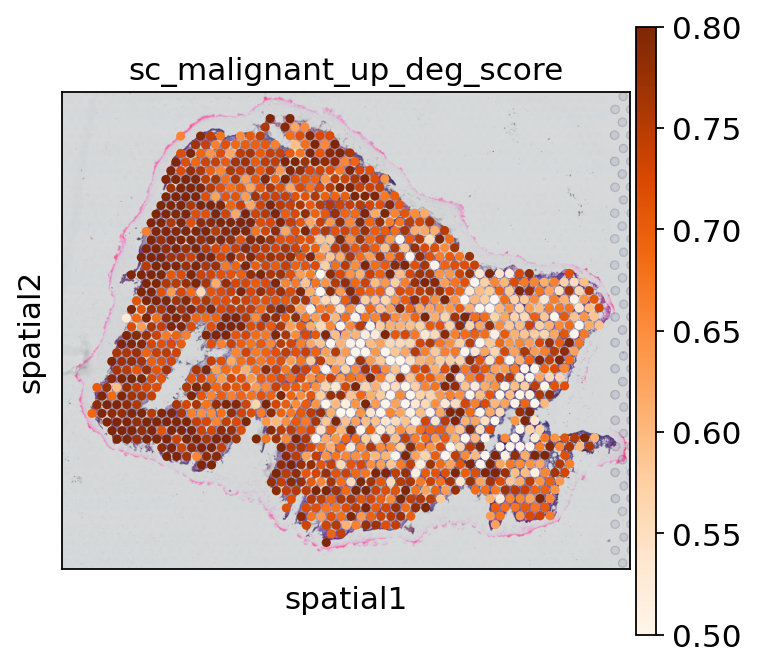

In [21]:
sc.pl.spatial(adata,  color='sc_malignant_up_deg_score', cmap='Oranges', vmin=0.5, vmax=0.8, size=1.4, save=f'_sc_malignant_up_deg_score.{prefix}.pdf')

In [23]:
sq.gr.spatial_neighbors(adata, n_rings=1, coord_type="grid", n_neighs=6)

raw_cluster = np.array(adata.obs['cluster2'].values)
spots = adata.obs_names.values

new_cluster = []

for cluster,spot in zip(raw_cluster,spots):
    nn_cluster = raw_cluster[np.where(np.array(adata.obsp["spatial_connectivities"][np.where(spots==spot)[0]].todense())[0]==1)[0]]

    if len(nn_cluster) < 2:
        new_cluster.append(cluster)
    else:
        unique_values, counts = np.unique(nn_cluster, return_counts=True)
        max_count_index = np.argmax(counts)
        most_common_element = unique_values[max_count_index]
        most_common_count = counts[max_count_index]

        if most_common_count / len(nn_cluster) > 0.5:
            new_cluster.append(most_common_element)
        else:
            new_cluster.append(cluster)

adata.obs['new_cluster'] = pd.Categorical(new_cluster, categories=['Normal','Tumor'])

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


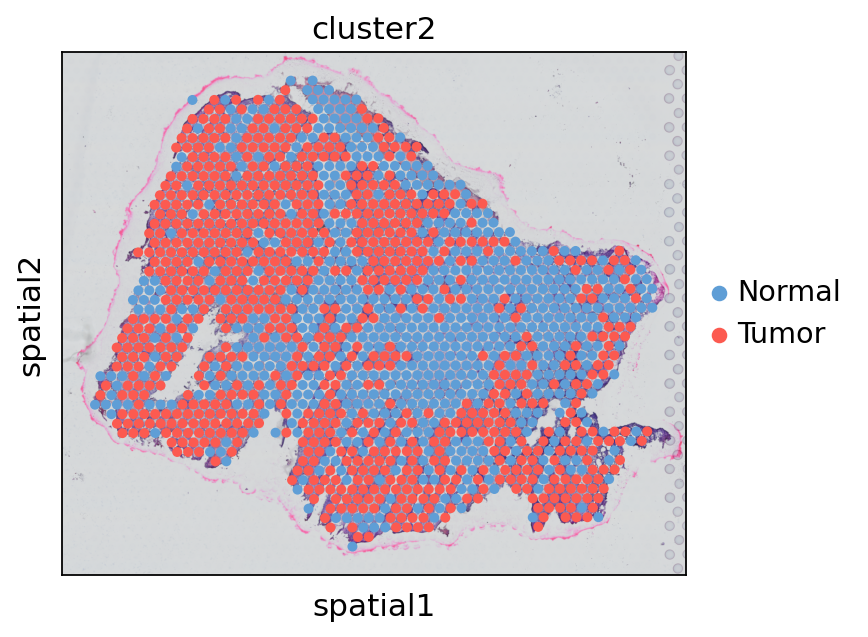

In [24]:
sc.pl.spatial(adata, color='cluster2', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_raw_prediction.{prefix}.2.pdf')

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


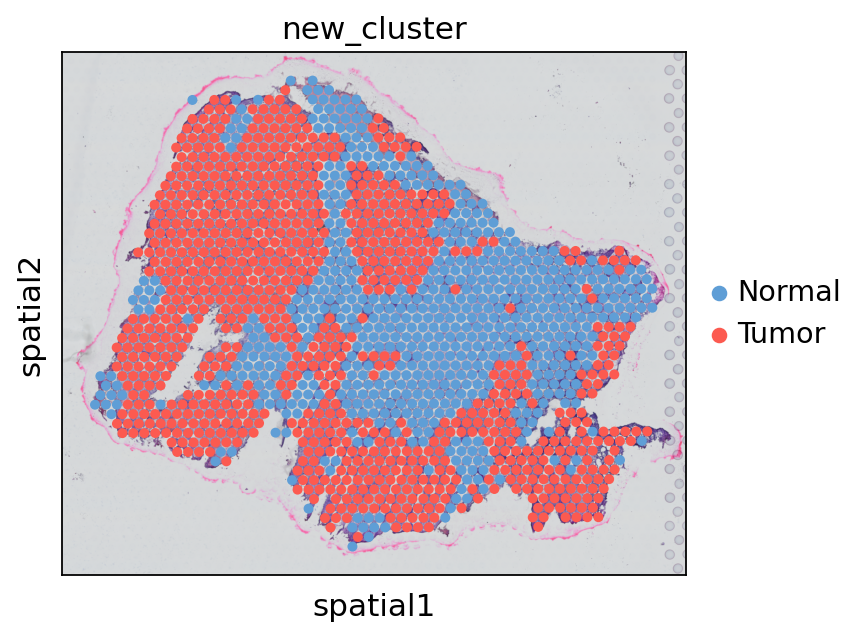

In [25]:
sc.pl.spatial(adata, color='new_cluster', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_prediction.{prefix}.2.pdf')

In [26]:
prefix = 'GSE208253_OSCC.s2'
adata = sample_dict[prefix]

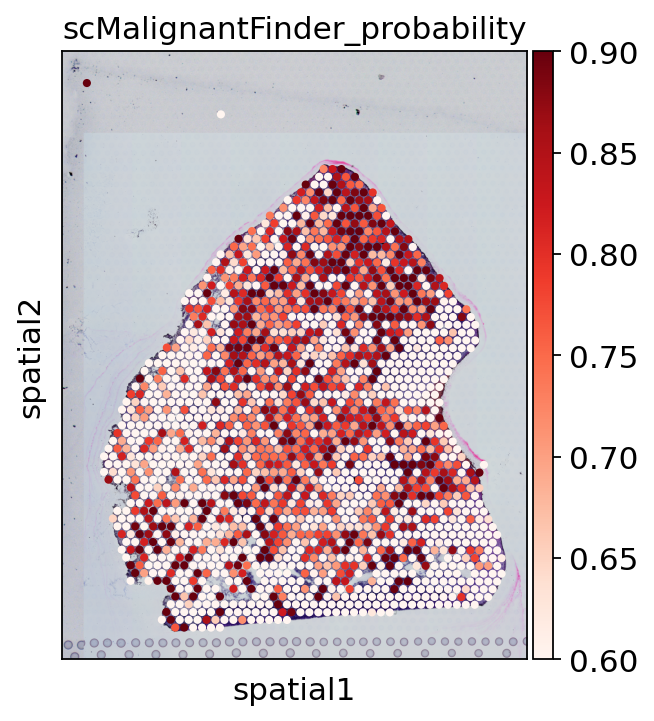

In [35]:
sc.pl.spatial(adata, color='scMalignantFinder_probability', cmap='Reds', vmin=0.6, vmax=0.9, size=1.4, save=f'_scMalignantFinder_probability.{prefix}.pdf')

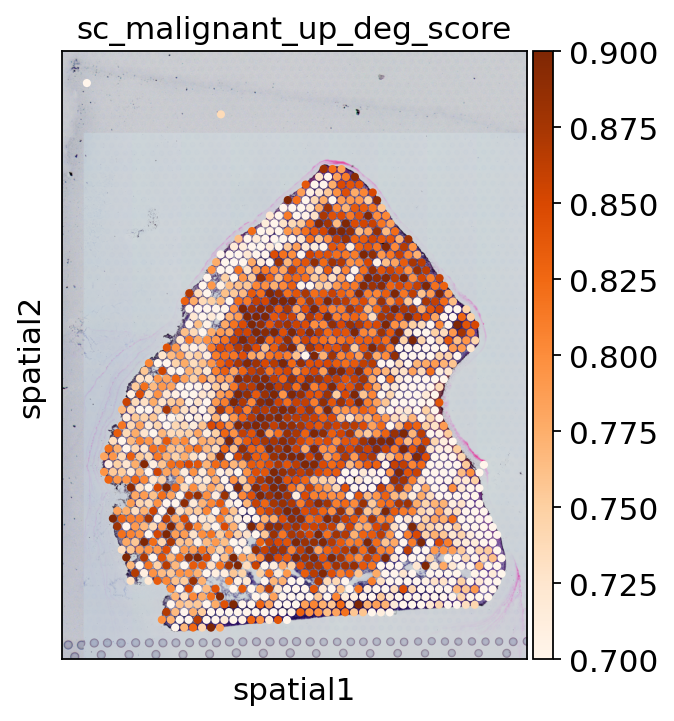

In [32]:
sc.pl.spatial(adata,  color='sc_malignant_up_deg_score', cmap='Oranges', vmin=0.7, vmax=0.9, size=1.4, save=f'_sc_malignant_up_deg_score.{prefix}.pdf')

In [36]:
sq.gr.spatial_neighbors(adata, n_rings=1, coord_type="grid", n_neighs=6)

raw_cluster = np.array(adata.obs['cluster2'].values)
spots = adata.obs_names.values

new_cluster = []

for cluster,spot in zip(raw_cluster,spots):
    nn_cluster = raw_cluster[np.where(np.array(adata.obsp["spatial_connectivities"][np.where(spots==spot)[0]].todense())[0]==1)[0]]

    if len(nn_cluster) < 2:
        new_cluster.append(cluster)
    else:
        unique_values, counts = np.unique(nn_cluster, return_counts=True)
        max_count_index = np.argmax(counts)
        most_common_element = unique_values[max_count_index]
        most_common_count = counts[max_count_index]

        if most_common_count / len(nn_cluster) > 0.5:
            new_cluster.append(most_common_element)
        else:
            new_cluster.append(cluster)

adata.obs['new_cluster'] = pd.Categorical(new_cluster, categories=['Normal','Tumor'])

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


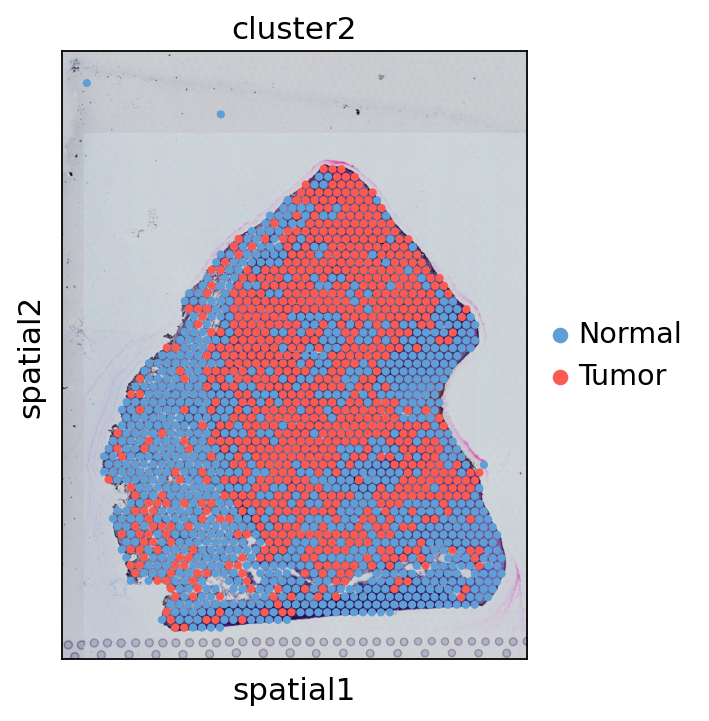

In [37]:
sc.pl.spatial(adata, color='cluster2', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_raw_prediction.{prefix}.2.pdf')

/mnt/home/qnyu/miniconda3/envs/scverse/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


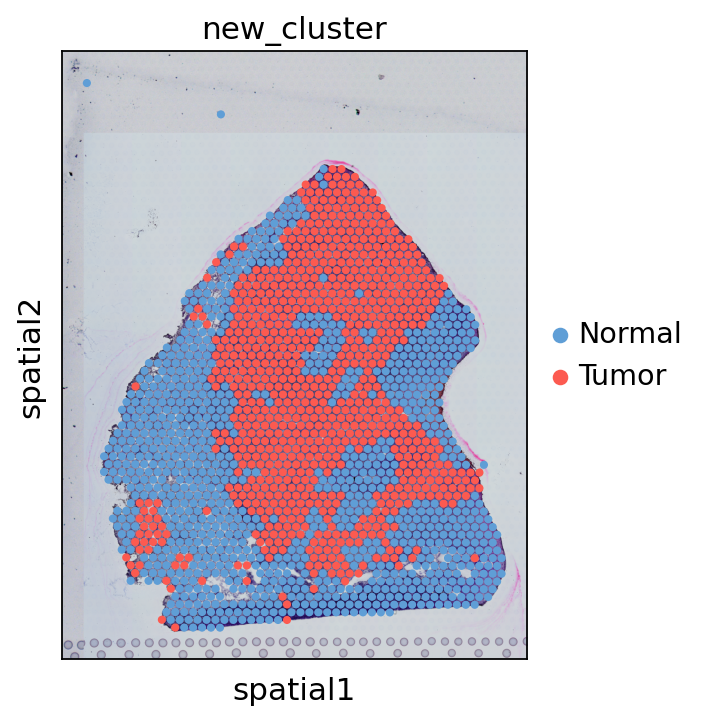

In [38]:
sc.pl.spatial(adata, color='new_cluster', palette=['#5f9ed6','#fc5a50'], size=1.4, save=f'_prediction.{prefix}.2.pdf')